# **Exploratory Data Analysis**

## **Requirements**

In [1]:
import polars as pl
pl.Config(fmt_str_lengths=50)
pl.Config(tbl_rows=25)
import numpy as np
import pandas as pd
import pickle
import plotly.express as px
import json

In [2]:
from BigEDA.preprocessing import prop_cols_nulls, perc_cols_nulls, columns_names
from BigEDA.descriptive import freq_table, kurtosis, skewness, outlier_detection # summary
from BigEDA.plots import (time_series_interactive_multiplot, scatterplot_interactive, 
                          lineplot_interactive, barplot_interactive, histogram_matrix, 
                          histogram_interactive, barplot_matrix, map_interactive, 
                          barplot_interactive_2D, barplot_interactive_2D_multiplot,
                          map_interactive_multiplot
                          )

In [3]:
def str_interval_to_bounds(str_interval):

    bracket_types = ['[]', '()', '[)', '(]']
    for bracket in bracket_types:
        try:
            lower_bound, upper_bound = [int(x) for x in str_interval.strip(bracket).split(',')]
            return lower_bound, upper_bound
        except:
            pass

    negative_types = ['<', '< ', '<=', '<= '] 
    positive_types = ['>', '> ', '>=', '>= ']

    for neg_type in negative_types:
        try:
            upper_bound = int(str_interval.strip(neg_type))
            lower_bound = - np.inf
            return lower_bound, upper_bound
        except:
            pass

    for pos_type in positive_types:
        try:
            lower_bound = int(str_interval.strip(pos_type))
            upper_bound = np.inf
            return lower_bound, upper_bound
        except:
            pass

In [4]:
def age_intervals_to_categories(unique_intervals, limits):
    # unique_intervals: a list or array of intervals in string format
    replace_dict = {}
    for str_interval in unique_intervals:
        lower_bound, upper_bound = str_interval_to_bounds(str_interval)  
        if upper_bound <= limits['young']:
            replace_dict[str_interval] = 'young' 
        elif lower_bound >= limits['old']:
            replace_dict[str_interval] = 'old' 
        else:
            replace_dict[str_interval] = 'adult' 
    return replace_dict

In [5]:
resources_web_app = {}

## **Reading the data**

In [6]:
acc_df = pl.read_csv(fr'C:\Users\fscielzo\Documents\DataScience-GitHub\EDA\Madrid-Traffic-Accidents\data\madrid_traffic_accidents.csv')

In [7]:
acc_df.head(4)

num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,tipo_persona,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga
str,str,str,str,str,i64,str,str,str,str,str,str,str,i64,str,f64,f64,bool,bool
"""2018S017842""","""04/02/2019""","""9:10:00""","""CALL. ALBERTO AGUILERA, 1""","""1""",1,"""Centro""","""Colisión lateral""","""Despejado""","""Moto""","""Conductor""","""[45,49]""","""Hombre""",7,"""Asist. solo insitu""",440068.049,4.4757e6,false,false
"""2018S017842""","""04/02/2019""","""9:10:00""","""CALL. ALBERTO AGUILERA, 1""","""1""",1,"""Centro""","""Colisión lateral""","""Despejado""","""Turismo""","""Conductor""","""[30,34]""","""Mujer""",7,"""Asist. solo insitu""",440068.049,4.4757e6,false,false
"""2019S000001""","""01/01/2019""","""3:45:00""","""PASEO. SANTA MARIA DE LA CABEZA / PLAZA. ELIPTICA""","""168""",11,"""Carabanchel""","""Alcance""",null,"""Furgoneta""","""Conductor""","""[40,44]""","""Hombre""",null,null,439139.603,4.4708e6,true,false
"""2019S000001""","""01/01/2019""","""3:45:00""","""PASEO. SANTA MARIA DE LA CABEZA / PLAZA. ELIPTICA""","""168""",11,"""Carabanchel""","""Alcance""",null,"""Turismo""","""Conductor""","""[40,44]""","""Mujer""",null,null,439139.603,4.4708e6,false,false


In [8]:
acc_df.shape

(233796, 19)

## **Missing values**

In [9]:
prop_cols_nulls(acc_df)

num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,tipo_persona,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga
f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
0.0,0.0,0.0,0.0,0.000034,0.000034,0.000034,0.000017,0.117701,0.005629,0.000013,0.109998,0.106687,0.45387,0.453917,0.00018,0.00018,0.003529,0.0


## **Feature engineering**

### **People-dependent variables**

#### **Severity of physical consequences**  

Fallecido, Ingreso > 24h --> high severity

"Asist. inmediata CS", "Ingreso <= 24h" --> medium severity

"Asist. posterior CS", "Urg. sin ingreso", 'Asist. solo insitu', "Sin asist. sanitaria" --> low severity

In [10]:
levels, replace_dict = {}, {}

levels['high'] = ['Fallecido', 'Ingreso > 24h']
levels['medium'] = ["Asist. inmediata CS", "Ingreso <= 24h"]
levels['low'] = ["Asist. posterior CS", "Urg. sin ingreso", 'Asist. solo insitu', "Sin asist. sanitaria"]

for level in levels.keys():
    replace_dict.update({x: level for x in levels[level]})

In [11]:
acc_df = acc_df.with_columns(pl.col('lesividad').replace(replace_dict).alias('phy_severity'))

#### **Age category**

In [12]:
unique_rango_edad = acc_df['rango_edad'].drop_nulls().unique().to_numpy()
limits = {'young': 24, 'old': 70}
replace_dict = age_intervals_to_categories(unique_intervals=unique_rango_edad, limits=limits)
acc_df = acc_df.with_columns(pl.col('rango_edad').replace(replace_dict).alias('age_category'))

### **Non-people dependent variables**

#### **Building new data-set**

In [13]:
n_unique_accidents = acc_df['num_expediente'].unique().len()
not_people_dependent_variables = []
for col in [x for x in acc_df.columns if x != 'num_expediente']:
    if acc_df.group_by('num_expediente').agg(pl.col(col).unique().len() == 1)[col].sum() == n_unique_accidents:
        not_people_dependent_variables.append(col)
people_dependent_variables = [x for x in acc_df.columns if x not in not_people_dependent_variables]

acc_not_people_df = {}
acc_not_people_df['num_expediente'] = acc_df['num_expediente'].unique(maintain_order=True) # maintain_order=True is essential to not mix info between different `num_expediente`
for col in [x for x in not_people_dependent_variables if x != 'num_expediente']:
    acc_not_people_df[col] = acc_df.group_by('num_expediente', maintain_order=True).agg(pl.col(col).unique())[col].map_elements(lambda x: x[0])
acc_not_people_df = pl.DataFrame(acc_not_people_df)

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\421632404.py:11: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  acc_not_people_df[col] = acc_df.group_by('num_expediente', maintain_order=True).agg(pl.col(col).unique())[col].map_elements(lambda x: x[0])


#### **Number of people involved in the accident**


In [14]:
acc_not_people_df = acc_df.group_by('num_expediente')\
                          .agg(pl.len().alias('num_people_involved'))\
                          .join(acc_not_people_df, on='num_expediente', how='inner')

#### **Year, quarter, month, week and day of the accident**

In [15]:
# Converting 'fecha' to date type
acc_not_people_df = acc_not_people_df.with_columns(pl.col("fecha").str.to_date("%d/%m/%Y").name.keep())
# Sort by date ('fecha')
acc_not_people_df = acc_not_people_df.sort('fecha')


In [16]:
# Formatting 'hora'
acc_not_people_df = acc_not_people_df.with_columns(acc_not_people_df['hora'].map_elements(lambda x : '0' + x if len(x.split(':')[0]) == 1 else x))
acc_not_people_df = acc_not_people_df.with_columns(pl.col("hora").str.to_time("%H:%M:%S").name.keep())


C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\3652790529.py:2: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  acc_not_people_df = acc_not_people_df.with_columns(acc_not_people_df['hora'].map_elements(lambda x : '0' + x if len(x.split(':')[0]) == 1 else x))


In [17]:
# Substracting day, week, month, quarter and year from the date
acc_not_people_df = acc_not_people_df.with_columns(acc_not_people_df['fecha'].dt.year().alias('year'),
                                                   acc_not_people_df['fecha'].dt.quarter().alias('quarter'),
                                                   acc_not_people_df['fecha'].dt.month().alias('month'),
                                                   acc_not_people_df['fecha'].dt.week().alias('week'),
                                                   acc_not_people_df['fecha'].dt.day().alias('day'),
                                                   acc_not_people_df['hora'].dt.hour().alias('hour'),
                                                   acc_not_people_df['fecha'].dt.weekday().alias('weekday'))

In [18]:
replace_weekday = {1: 'Monday',
                   2: 'Tuesday',
                   3: 'Wednesday',
                   4: 'Thursday',
                   5: 'Friday',
                   6: 'Saturday',
                   7: 'Sunday'
}

acc_not_people_df = acc_not_people_df.with_columns(pl.col('weekday').cast(str).replace(replace_weekday).alias('weekday'))

#### **Number of accidents per day, week, month, quarter and year** 

In [19]:
num_acc_time_series = {}
# Num accidents by year
num_acc_time_series['year'] = acc_not_people_df.group_by(['year']).agg(pl.len().alias('num_accidents'))
# Num accidents by quarter (aggregating years 2019-2024)
num_acc_time_series['quarter'] = acc_not_people_df.group_by(['quarter']).agg(pl.len().alias('num_accidents')).sort(['quarter'])
# Num accidents by month (aggregating years 2019-2024)
num_acc_time_series['month'] = acc_not_people_df.group_by(['month']).agg(pl.len().alias('num_accidents')).sort(['month'])
# Num accidents by week (aggregating years 2019-2024)
num_acc_time_series['week'] = acc_not_people_df.group_by(['week']).agg(pl.len().alias('num_accidents')).sort(['week'])
# Num accidents by day (aggregating years 2019-2024)
num_acc_time_series['day'] = acc_not_people_df.group_by(['day']).agg(pl.len().alias('num_accidents')).sort(['day'])
# Num accidents by hour (aggregating years 2019-2024)
num_acc_time_series['hour'] = acc_not_people_df.group_by(['hour']).agg(pl.len().alias('num_accidents')).sort(['hour'])
# Num accidents by year-quarter 
num_acc_time_series['year-quarter'] = acc_not_people_df.group_by(['year', 'quarter']).agg(pl.len().alias('num_accidents')).sort(['year', 'quarter'])
# Num accidents by year-month 
num_acc_time_series['year-month'] = acc_not_people_df.group_by(['year', 'month']).agg(pl.len().alias('num_accidents')).sort(['year', 'month'])
# Num accidents by year-month_day 
num_acc_time_series['year-month-day'] = acc_not_people_df.group_by(['year', 'month', 'day']).agg(pl.len().alias('num_accidents')).sort(['year', 'month', 'day'])

In [20]:
num_acc_time_series['year-quarter'] = num_acc_time_series['year-quarter'].with_columns(
    (pl.col("year").cast(pl.Utf8) + "-Q" + pl.col("quarter").cast(pl.Utf8)).alias("year-quarter")
)
num_acc_time_series['year-month'] = num_acc_time_series['year-month'].with_columns(
    (pl.col("year").cast(pl.Utf8) + "-" + pl.col("month").cast(pl.Utf8).str.zfill(2) + "-01").alias("year-month").str.strptime(pl.Date, "%Y-%m-%d")
)
num_acc_time_series['year-month-day'] = num_acc_time_series['year-month-day'].with_columns(
    (pl.col("year").cast(pl.Utf8) + "-" + pl.col("month").cast(pl.Utf8).str.zfill(2) + "-" + pl.col("day").cast(pl.Utf8).str.zfill(2)).alias("year-month-day").str.strptime(pl.Date, "%Y-%m-%d")
)

In [21]:
df = acc_not_people_df.group_by('weekday').agg(pl.len().alias('num_accidents'))
new_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
new_order_df = pl.DataFrame({'weekday': new_order,
                             'weekday_rename': [str(i+1) + '-' + x for i,x in enumerate(new_order)]})
num_acc_time_series['weekday'] = df.join(new_order_df, on='weekday').select(['weekday_rename', 'num_accidents']).rename({'weekday_rename': 'weekday'})

#### **Some positive in alcohol or drugs between the involved people** 

In [22]:
acc_not_people_df = acc_df.group_by('num_expediente').agg(pl.col(['positiva_alcohol', 'positiva_droga']))\
                          .with_columns((pl.lit(True).is_in(pl.col("positiva_alcohol")) | pl.lit(True).is_in(pl.col("positiva_droga"))).alias('some_positive_involved'))\
                          .select(['num_expediente', 'some_positive_involved'])\
                          .join(acc_not_people_df, on='num_expediente', how='inner')

#### **Some death between the involved people**

In [23]:
acc_not_people_df = acc_df.group_by('num_expediente').agg(pl.col('lesividad'))\
                          .with_columns(pl.when(pl.lit('Fallecido').is_in(pl.col('lesividad')))\
                          .then(True)\
                          .otherwise(False)\
                          .alias('some_death_involved'))\
                          .select(['num_expediente', 'some_death_involved'])\
                          .join(acc_not_people_df, on='num_expediente', how='inner')

#### **Severe accident**

Severe accident := Some people severely affected by the accident

In [24]:
acc_not_people_df = acc_df.group_by('num_expediente').agg(pl.col('phy_severity'))\
                          .with_columns(pl.when(pl.lit('high').is_in(pl.col('phy_severity')))\
                          .then(True)\
                          .otherwise(False)\
                          .alias('severe_accident'))\
                          .select(['num_expediente', 'severe_accident'])\
                          .join(acc_not_people_df, on='num_expediente', how='inner')

#### **Old driver involved**

In [25]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('rango_edad'))\
                            .with_columns(
                            pl.when(pl.col('rango_edad').map_elements(lambda ages: all(age in ['[70,74]', '>74'] for age in ages)))
                            .then(pl.lit(True))
                            .otherwise(pl.lit(False))
                            .alias('only_old_driver_involved'))\
                            .select(['num_expediente', 'only_old_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\3378587310.py:3: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  .with_columns(


In [26]:
np.unique(acc_not_people_df['only_old_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([99584,   345]))

In [27]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('rango_edad'))\
                            .with_columns(
                            pl.when(pl.col('rango_edad').map_elements(lambda ages: any(age in ['[70,74]', '>74'] for age in ages)))
                            .then(pl.lit(True))
                            .otherwise(pl.lit(False))
                            .alias('old_driver_involved'))\
                            .select(['num_expediente', 'old_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\439533026.py:3: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  .with_columns(


In [28]:
np.unique(acc_not_people_df['old_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([97723,  2206]))

#### **Young driver involved**

In [29]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('rango_edad'))\
                            .with_columns(
                            pl.when(pl.col('rango_edad').map_elements(lambda ages: any(age in ['[18,20]', '[21,24]'] for age in ages)))
                            .then(pl.lit(True))
                            .otherwise(pl.lit(False))
                            .alias('young_driver_involved'))\
                            .select(['num_expediente', 'young_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\374699022.py:3: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  .with_columns(


In [30]:
np.unique(acc_not_people_df['young_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([84822, 15107]))

In [31]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('rango_edad'))\
                            .with_columns(
                            pl.when(pl.col('rango_edad').map_elements(lambda ages: all(age in ['[18,20]', '[21,24]'] for age in ages)))
                            .then(pl.lit(True))
                            .otherwise(pl.lit(False))
                            .alias('only_young_driver_involved'))\
                            .select(['num_expediente', 'only_young_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\3877581671.py:3: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  .with_columns(


In [32]:
np.unique(acc_not_people_df['only_young_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([96329,  3600]))

#### **Female driver involved**

In [33]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('sexo'))\
                            .with_columns(
                            pl.when(pl.lit('Mujer').is_in(pl.col('sexo')))
                            .then(pl.lit(True))
                            .otherwise(pl.lit(False))
                            .alias('female_driver_involved'))\
                            .select(['num_expediente', 'female_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')

In [34]:
np.unique(acc_not_people_df['female_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([63456, 36473]))

In [35]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('sexo'))\
                            .with_columns(pl.col('sexo').map_elements(lambda x: all(s == "Mujer" for s in x))\
                            .alias('only_female_driver_involved'))\
                            .select(['num_expediente', 'only_female_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')
 

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\69233327.py:3: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  .with_columns(pl.col('sexo').map_elements(lambda x: all(s == "Mujer" for s in x))\


In [36]:
np.unique(acc_not_people_df['only_female_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([90769,  9160]))

#### **Male driver involved**

In [37]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('sexo'))\
                            .with_columns(pl.lit('Hombre').is_in(pl.col('sexo')).alias('male_driver_involved'))\
                            .select(['num_expediente', 'male_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')

In [38]:
# Equivalent way to do that
'''
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('sexo'))\
                            .with_columns(
                            pl.when(pl.lit('Hombre').is_in(pl.col('sexo')))
                            .then(pl.lit(True))
                            .otherwise(pl.lit(False))
                            .alias('male_driver_involved'))\
                            .select(['num_expediente', 'male_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')
'''

"\nacc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')                            .group_by('num_expediente').agg(pl.col('sexo'))                            .with_columns(\n                            pl.when(pl.lit('Hombre').is_in(pl.col('sexo')))\n                            .then(pl.lit(True))\n                            .otherwise(pl.lit(False))\n                            .alias('male_driver_involved'))                            .select(['num_expediente', 'male_driver_involved'])                            .join(acc_not_people_df, on='num_expediente', how='inner')\n"

In [39]:
np.unique(acc_not_people_df['male_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([16091, 83838]))

In [40]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('sexo'))\
                            .with_columns(pl.col('sexo').map_elements(lambda x: all(value == "Hombre" for value in x))\
                            .alias('only_male_driver_involved'))\
                            .select(['num_expediente', 'only_male_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')
 

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23180\547718369.py:3: MapWithoutReturnDtypeWarning: Calling `map_elements` without specifying `return_dtype` can lead to unpredictable results. Specify `return_dtype` to silence this warning.
  .with_columns(pl.col('sexo').map_elements(lambda x: all(value == "Hombre" for value in x))\


In [41]:
np.unique(acc_not_people_df['only_male_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([49397, 50532]))

### **Drugged or alcoholized driver involved**

In [42]:
acc_df = acc_df.with_columns(
    pl.when((pl.col('positiva_droga') | pl.col('positiva_alcohol')))
    .then(pl.lit(True))
    .otherwise(pl.lit(False))
    .alias('positive')
)

In [43]:
acc_not_people_df = acc_df.filter(pl.col('tipo_persona') == 'Conductor')\
                            .group_by('num_expediente').agg(pl.col('positive'))\
                            .with_columns(pl.lit(True).is_in(pl.col('positive')).alias('positive_driver_involved'))\
                            .select(['num_expediente', 'positive_driver_involved'])\
                            .join(acc_not_people_df, on='num_expediente', how='inner')

In [44]:
np.unique(acc_not_people_df['positive_driver_involved'].to_numpy(), return_counts=True)

(array([False,  True]), array([92726,  7203]))

#### **Updating list of non-people dependent variables**

In [45]:
not_people_dependent_variables = acc_not_people_df.columns

#### **Saving the new data-set**

In [46]:
acc_not_people_df.write_csv(r'\data\not_people_madrid_traffic_accidents.csv')

## **General Analysis**

### **Descriptive summary**

In [47]:
acc_df.quantile(0.25).to_numpy().flatten()

array([None, None, None, None, None, 5.0, None, None, None, None, None,
       None, None, 7.0, None, 439938.982, 4471743.378, None, None, None,
       None, None], dtype=object)

In [48]:
quant_col_names=['num_people_involved']

In [49]:
acc_not_people_df[quant_col_names].quantile(0.25).to_numpy().flatten()

array([2.])

In [50]:
kurtosis(acc_not_people_df['num_people_involved'], scipy=True)

np.float64(38.37293939537607)

In [51]:
def summary2(df, auto_col=False, quant_col_names=[], cat_col_names=[]) :

    if auto_col == True :
        quant_col_names = columns_names(df, types=[pl.Float64, pl.Int64])
        cat_col_names = columns_names(df, types=[pl.Boolean, pl.Utf8])

    elif auto_col == False : 
        # colnames debe ser un objeto tipo colnames = [list_quant_columns , list_cat_columns]
        # Ejemplo: colnames = [['quant_1' , 'quant_2'], ['cat_1', 'cat_2', 'cat_3']]
        quant_col_names = quant_col_names
        cat_col_names = cat_col_names

    n_rows = len(df)

    if len(quant_col_names) > 0 :
         
        # mean_quant_cols = [df[col].mean() for col in quant_col_names]
        mean_quant_cols = df[quant_col_names].mean().to_numpy().flatten()
        # std_quant_cols = [df[col].std() for col in quant_col_names]
        std_quant_cols = df[quant_col_names].std().to_numpy().flatten()
        # median_quant_cols = [df[col].median() for col in quant_col_names]
        median_quant_cols = df[quant_col_names].median().to_numpy().flatten()
        # Q25_quant_cols = [df[col].quantile(0.10) for col in quant_col_names]
        Q25_quant_cols = df[quant_col_names].quantile(0.25).to_numpy().flatten()
        # Q10_quant_cols = [df[col].quantile(0.25) for col in quant_col_names]
        Q10_quant_cols = df[quant_col_names].quantile(0.10).to_numpy().flatten()
        # Q75_quant_cols = [df[col].quantile(0.75) for col in quant_col_names]
        Q75_quant_cols = df[quant_col_names].quantile(0.75).to_numpy().flatten()
        # Q90_quant_cols = [df[col].quantile(0.90) for col in quant_col_names]
        Q90_quant_cols = df[quant_col_names].quantile(0.90).to_numpy().flatten()
        # max_quant_cols = [df[col].max() for col in quant_col_names]
        max_quant_cols = df[quant_col_names].max().to_numpy().flatten()
        # min_quant_cols = [df[col].min() for col in quant_col_names]
        min_quant_cols = df[quant_col_names].min().to_numpy().flatten()
        kurtosis_quant_cols = [kurtosis(df[col], scipy=True) for col in quant_col_names]
        skewness_quant_cols = [skewness(df[col], scipy=True) for col in quant_col_names]

        prop_outliers = []
        for col in quant_col_names :
           _, outliers, _, _ = outlier_detection(X=df[col], h=1.5)
           prop_outliers.append(len(outliers)/n_rows)

        num_unique_values_quant_col = []
        for col in quant_col_names :
            unique_values = df[col].unique().to_numpy()
            unique_values = [x for x in unique_values if x is not None]
            num_unique_values_quant_col.append(len(unique_values))

        perc_nulls_quant_cols = perc_cols_nulls(df[quant_col_names])

        quant_summary = pd.DataFrame(index=quant_col_names, 
                                    columns=['n_unique', 'perc_nan', 'mean','std','min','Q10','Q25','median','Q75', 'Q90','max', 
                                             'kurtosis', 'skew', 'prop_outliers'])

        quant_summary.loc[:,'n_unique'] = num_unique_values_quant_col
        quant_summary.loc[:,'perc_nan'] = perc_nulls_quant_cols
        quant_summary.loc[:,'mean'] = mean_quant_cols
        quant_summary.loc[:,'std'] = std_quant_cols
        quant_summary.loc[:,'min'] = min_quant_cols
        quant_summary.loc[:,'Q10'] = Q10_quant_cols
        quant_summary.loc[:,'Q25'] = Q25_quant_cols
        quant_summary.loc[:,'median'] = median_quant_cols 
        quant_summary.loc[:,'Q75'] = Q75_quant_cols
        quant_summary.loc[:,'Q90'] = Q90_quant_cols
        quant_summary.loc[:,'max'] = max_quant_cols
        quant_summary.loc[:,'kurtosis'] = kurtosis_quant_cols
        quant_summary.loc[:,'skew'] = skewness_quant_cols
        quant_summary.loc[:,'prop_outliers'] = prop_outliers

    else :

        quant_summary = None


    if len(cat_col_names) > 0 :

        mode_cat_cols = [df[col].mode()[0] for col in cat_col_names]

        num_unique_values_cat_col = []
        for col in cat_col_names :
            unique_values = df[col].unique().to_numpy()
            unique_values = [x for x in unique_values if x is not None]
            num_unique_values_cat_col.append(len(unique_values))

        perc_nulls_cat_cols = perc_cols_nulls(df[cat_col_names])

        cat_summary = pd.DataFrame(index=cat_col_names, 
                                   columns=['n_unique', 'perc_nan', 'mode'])

        cat_summary.loc[:,'n_unique'] = num_unique_values_cat_col
        cat_summary.loc[:,'perc_nan'] = perc_nulls_cat_cols
        cat_summary.loc[:,'mode'] = mode_cat_cols

    else :

        cat_summary = None
  
    return quant_summary, cat_summary

In [52]:
_, cat_summary_1 = summary2(df=acc_df, auto_col=False,
                        quant_col_names=[],
                        cat_col_names=people_dependent_variables)

quant_summary_2, cat_summary_2 = summary2(df=acc_not_people_df, auto_col=False,
                                     quant_col_names=['num_people_involved'],
                                     cat_col_names= [x for x in not_people_dependent_variables 
                                                     if x not in ['num_people_involved', 'fecha']])

In [53]:
cat_summary_1

,n_unique,perc_nan,mode
num_expediente,99931,0.0,2023S039284
tipo_vehiculo,20,0.56,Turismo
tipo_persona,3,0.0,Conductor
rango_edad,17,11.0,None
sexo,2,10.67,Hombre
cod_lesividad,10,45.39,None
lesividad,8,45.39,None
positiva_alcohol,2,0.35,False
positiva_droga,2,0.0,False
phy_severity,3,45.39,low


In [54]:
cat_summary = pd.concat([cat_summary_1, cat_summary_2], axis=0)
cat_summary

,n_unique,perc_nan,mode
num_expediente,99931,0.0,2023S039284
tipo_vehiculo,20,0.56,Turismo
tipo_persona,3,0.0,Conductor
rango_edad,17,11.0,None
sexo,2,10.67,Hombre
cod_lesividad,10,45.39,None
lesividad,8,45.39,None
positiva_alcohol,2,0.35,False
positiva_droga,2,0.0,False
phy_severity,3,45.39,low


In [55]:
quant_summary_2

,n_unique,perc_nan,mean,std,min,Q10,Q25,median,Q75,Q90,max,kurtosis,skew,prop_outliers
num_people_involved,24,0.0,2.339531,1.156622,1,1.0,2.0,2.0,3.0,4.0,44,38.372939,2.956254,0.049575


### **Frequency table**

In [93]:
for col in people_dependent_variables:
    print(f'\n----------------------------------------------\nFrequency table for {col}\n----------------------------------------------')
    acc_df_dropped_nulls = acc_df.drop_nulls(subset=col)
    display(freq_table(X=acc_df_dropped_nulls[col]))


----------------------------------------------
Frequency table for num_expediente
----------------------------------------------


num_expediente: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""2023S039284""",44,0.0002,44,0.000188
"""2022S002867""",36,0.0002,80,0.000342
"""2023S019009""",23,0.0001,103,0.000441
"""2022S000670""",21,0.0001,124,0.00053
"""2022S009268""",20,0.0001,144,0.000616
"""2022S040320""",20,0.0001,164,0.000701
"""2020S007629""",19,0.0001,183,0.000783
"""2021S024511""",18,0.0001,201,0.00086
"""2021S024955""",17,0.0001,218,0.000932



----------------------------------------------
Frequency table for tipo_vehiculo
----------------------------------------------


tipo_vehiculo: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""Turismo""",161920,0.6965,161920,0.69649
"""Moto""",29664,0.1276,191584,0.824088
"""Furgoneta""",15093,0.0649,206677,0.88901
"""Autobus""",6662,0.0287,213339,0.917666
"""Camión rígido""",5401,0.0232,218740,0.940898
"""Bicicleta""",4648,0.02,223388,0.960891
"""Todo terreno""",3426,0.0147,226814,0.975628
"""VMU eléctrico""",2491,0.0107,229305,0.986343
"""Tractocamión""",960,0.0041,230265,0.990472



----------------------------------------------
Frequency table for tipo_persona
----------------------------------------------


tipo_persona: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""Conductor""",188757,0.8074,188757,0.807368
"""Pasajero""",36957,0.1581,225714,0.965444
"""Peatón""",8079,0.0346,233793,1.0



----------------------------------------------
Frequency table for rango_edad
----------------------------------------------


rango_edad: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""[25,29]""",24214,0.1164,24214,0.116369
"""[40,44]""",24212,0.1164,48426,0.232729
"""[30,34]""",23943,0.1151,72369,0.347796
"""[35,39]""",23051,0.1108,95420,0.458576
"""[45,49]""",22781,0.1095,118201,0.568058
"""[50,54]""",19646,0.0944,137847,0.662474
"""[21,24]""",15758,0.0757,153605,0.738205
"""[55,59]""",15738,0.0756,169343,0.81384
"""[60,64]""",10225,0.0491,179568,0.86298



----------------------------------------------
Frequency table for sexo
----------------------------------------------


sexo: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""Hombre""",141260,0.6764,141260,0.676361
"""Mujer""",67593,0.3236,208853,1.0



----------------------------------------------
Frequency table for cod_lesividad
----------------------------------------------


cod_lesividad: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
i64,i64,f64,i64,f64
14,70346,0.5509,70346,0.550943
7,30040,0.2353,100386,0.786213
2,9155,0.0717,109541,0.857914
1,6660,0.0522,116201,0.910074
6,5753,0.0451,121954,0.955131
5,2879,0.0225,124833,0.977679
3,2689,0.0211,127522,0.998739
4,150,0.0012,127672,0.999914
77,11,0.0001,127683,1.0



----------------------------------------------
Frequency table for lesividad
----------------------------------------------


lesividad: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""Sin asist. sanitaria""",70346,0.551,70346,0.55099
"""Asist. solo insitu""",30040,0.2353,100386,0.78628
"""Ingreso <= 24h""",9155,0.0717,109541,0.857988
"""Urg. sin ingreso""",6660,0.0522,116201,0.910153
"""Asist. inmediata CS""",5753,0.0451,121954,0.955213
"""Asist. posterior CS""",2879,0.0225,124833,0.977763
"""Ingreso > 24h""",2689,0.0211,127522,0.998825
"""Fallecido""",150,0.0012,127672,1.0



----------------------------------------------
Frequency table for positiva_alcohol
----------------------------------------------


positiva_alcohol: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
bool,i64,f64,i64,f64
false,226173,0.9708,226173,0.97082
true,6798,0.0292,232971,1.0



----------------------------------------------
Frequency table for positiva_droga
----------------------------------------------


positiva_droga: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
bool,i64,f64,i64,f64
false,233059,0.9968,233059,0.996848
true,737,0.0032,233796,1.0



----------------------------------------------
Frequency table for phy_severity
----------------------------------------------


phy_severity: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""low""",109925,0.861,109925,0.860995
"""medium""",14908,0.1168,124833,0.977763
"""high""",2839,0.0222,127672,1.0



----------------------------------------------
Frequency table for age_category
----------------------------------------------


age_category: unique values,abs_freq,rel_freq,cum_abs_freq,cum_rel_freq
str,i64,f64,i64,f64
"""adult""",168743,0.811,168743,0.810956
"""young""",30933,0.1487,199676,0.959616
"""old""",8403,0.0404,208079,1.0


In [48]:
'''
for col in not_people_dependent_variables:
    print(f'\n----------------------------------------------\nFrequency table for {col}\n----------------------------------------------')
    acc_not_people_df_drop_nulls = acc_not_people_df.drop_nulls(subset=col)
    display(freq_table(X=acc_not_people_df_drop_nulls[col]))
'''

"\nfor col in not_people_dependent_variables:\n    print(f'\n----------------------------------------------\nFrequency table for {col}\n----------------------------------------------')\n    acc_not_people_df_drop_nulls = acc_not_people_df.drop_nulls(subset=col)\n    display(freq_table(X=acc_not_people_df_drop_nulls[col]))\n"

### **Visualization**

#### **Barplot**

##### **For people-dependent variables**

In [49]:
n_unique = {}
for col in people_dependent_variables:
    n_unique[col] = len(acc_df[col].unique())
    
columns_to_plot_people_dependent = [x for x in people_dependent_variables if n_unique[x] <= 40 and x not in ['cod_lesividad']]

# Defining an order for the categories of 'rango_edad'
def custom_sort(s):
    return int(s.split(',')[0][1:])
categories_order = {}
for col in columns_to_plot_people_dependent: # the order will be defined only for 'rango_edad', setting None for the rest.
    categories_order[col] = None
categories_order['rango_edad'] = sorted(acc_df['rango_edad'].unique().drop_nulls(), key=custom_sort)

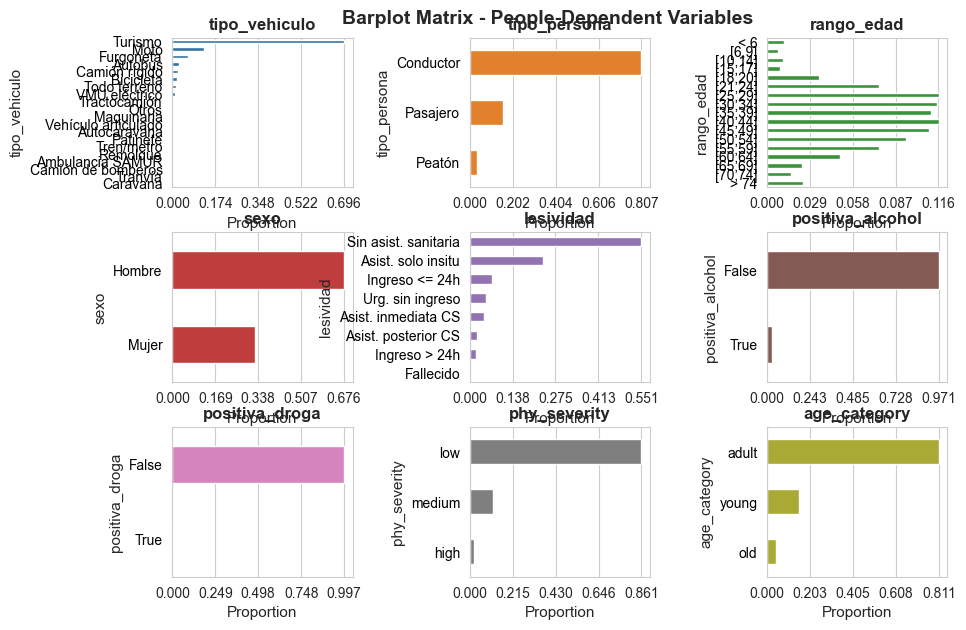

In [50]:
# Making the plot
barplot_matrix(acc_df, n_cols=3, title='Barplot Matrix - People-Dependent Variables', orientation='horizontal',
               figsize=(10, 7), auto_col=False, cat_col_names=columns_to_plot_people_dependent, title_height=0.92,
               hspace=0.3, wspace=0.65, x_rotation=0, title_fontsize=14, subtitles_fontsize=12, 
               n_xticks=5, n_round_xticks=3, xlabel_size=11, ylabel_size=11, xticks_size=10, yticks_size=10,
               order=categories_order, bar_width=0.5)

##### **For non-people-dependent variables**

In [160]:
columns_to_plot_non_people_dependent = [x for x in not_people_dependent_variables if x not in ['num_expediente', 'fecha', 'hora', 'week', 'numero', 'localizacion', 'cod_distrito', 'coordenada_x_utm', 'coordenada_y_utm']]
columns_to_plot_non_people_dependent_histogram = ['num_people_involved', 'year', 'quarter', 'month', 'week', 'day', 'hour']
columns_to_plot_non_people_dependent_barplot = [x for x in columns_to_plot_non_people_dependent if x not in columns_to_plot_non_people_dependent_histogram]

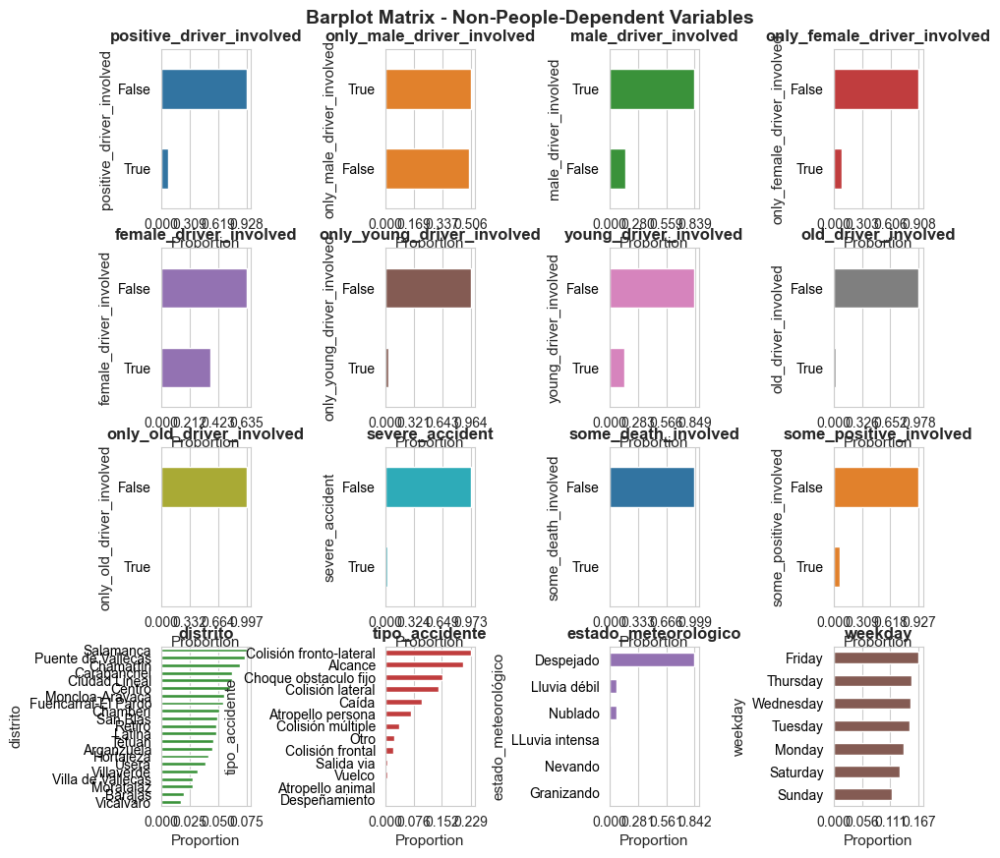

In [97]:
barplot_matrix(acc_not_people_df, n_cols=4, title='Barplot Matrix - Non-People-Dependent Variables', orientation='horizontal',
               figsize=(10, 10), cat_col_names=columns_to_plot_non_people_dependent_barplot, title_height=0.92,
               hspace=0.25, wspace=1.5, x_rotation=0, title_fontsize=14, subtitles_fontsize=12, 
               n_xticks=4, n_round_xticks=3, xlabel_size=11, ylabel_size=11, xticks_size=10, yticks_size=10,
               bar_width=0.5)

#### **Histogram** 

##### **For non-people-dependent variables**

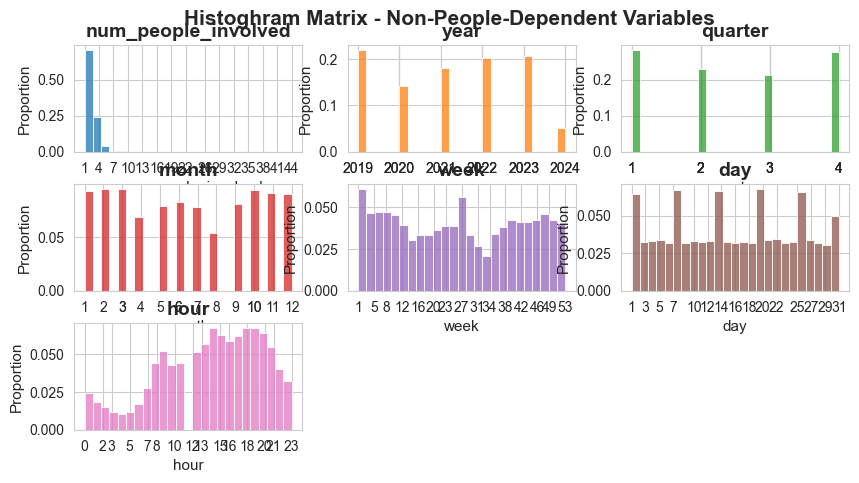

In [98]:
histogram_matrix(acc_not_people_df, bins=25, n_cols=3, title='Histoghram Matrix - Non-People-Dependent Variables', 
                     figsize=(10,5), quant_col_names=columns_to_plot_non_people_dependent_histogram,
                     n_xticks=15, title_fontsize=15, subtitles_fontsize=14, 
                     x_rotation=0, y_rotation=0, title_height=0.95, style='whitegrid', hspace=0.3, wspace=0.2,
                     n_round_xticks=0, title_weight='bold', xlabel_size=11, ylabel_size=11, 
                     xticks_size=10, yticks_size=10)

In [47]:
histogram_interactive(X=acc_not_people_df['num_people_involved'], figsize=(600,400), font_family='Comic Sans MS', title_size=20, 
                          xlabel_size=12, ylabel_size=12, xticks_size=10, yticks_size=10, 
                          color='tomato', nbins=35,
                          margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                          title_width=0.5, title_height=1.1)

In [51]:
barplot_interactive(X=acc_df['rango_edad'], figsize=(440,500), font_family='Comic Sans MS', 
                    title_size=20, color='tomato', xlabel_size=17, ylabel_size=17,
                    xticks_size=14, yticks_size=14,
                    margin_l=50, margin_r=50, title_width=0.5, title_height=1.09,
                    categories_order=categories_order['rango_edad'])

In [52]:
barplot_interactive(X=acc_df['rango_edad'], figsize=(1000,500), font_family='Comic Sans MS', 
                    title_size=20, color='tomato', xlabel_size=13, ylabel_size=17,
                    xticks_size=14, yticks_size=14, orientation='v',
                    margin_l=50, margin_r=50, title_width=0.5, title_height=1.09,
                    categories_order=categories_order['rango_edad'])

## **Specific Analysis**

### **More data about the districts**

In [53]:
with open(r'C:\Users\fscielzo\Documents\Streamlit-Apps\Madrid-Traffic-Accidents-App\data\district_data.pickle', 'rb') as file:
    district_data = pickle.load(file)

In [54]:
df1 = acc_not_people_df.drop_nulls(subset=['distrito'])\
                       .group_by('distrito').agg(pl.col('num_expediente').len().alias('num_accidents'))
df2 = acc_not_people_df.drop_nulls(subset=['distrito'])\
                       .group_by('distrito').agg(pl.col('severe_accident').sum().alias('num_severe_accident'))
district_data['accidents'] = df1.join(df2, on='distrito', how='inner')
districts_df = district_data['accidents'].join(district_data['extranjeros_distritos'], on='distrito', how='inner')
districts_df = districts_df.join(district_data['intervenciones_policiales_distritos'], on='distrito', how='inner')
districts_df = districts_df.join(district_data['poblacion_distritos'], on='distrito', how='inner')
districts_df = districts_df.join(district_data['indicadores_distritos_barrios'][['distrito', 'Renta disponible media por persona']], on='distrito', how='inner')
districts_df = districts_df.select(pl.exclude('Total Población', 'Crecimiento migratorio / Tasa de inmigración'))
districts_df = districts_df.with_columns(((pl.col('intervenciones_policiales_con_detenidos')/pl.col('poblacion'))*1000).round(2).alias('detenidos_mil_hab'))
districts_df = districts_df.with_columns(((pl.col('num_accidents')/pl.col('poblacion'))*1000).round(2).alias('acc_mil_hab'))
districts_df = districts_df.with_columns(((pl.col('num_severe_accident')/pl.col('poblacion'))*1000).round(2).alias('severe_acc_mil_hab'))
districts_df = districts_df.rename({'Renta disponible media por persona': 'renta_media_persona'})
districts_df = districts_df.with_columns(((pl.col('num_accidents')/districts_df['num_accidents'].sum())*100).round(2).alias('perc_acc'))
districts_df = districts_df.with_columns(((pl.col('num_severe_accident')/districts_df['num_severe_accident'].sum())*100).round(2).alias('perc_severe_acc'))

In [55]:
districts_df

distrito,num_accidents,num_severe_accident,poblacion,poblacion_española,poblacion_extranjera,perc_poblacion_extranjera,intervenciones_policiales_con_detenidos,% de 0 a 15 años,% de 16 a 64 años,% de 65 años y más,% de 80 años y más,Edad promedio,renta_media_persona,detenidos_mil_hab,acc_mil_hab,severe_acc_mil_hab,perc_acc,perc_severe_acc
str,u32,u32,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""Arganzuela""",4483,138,154073.0,137201.0,16867.0,10.95,266.0,11.79,67.76,20.45,6.31,45.28,23370.25,1.73,29.1,0.9,4.49,5.16
"""Chamberi""",5041,158,138656.0,120452.0,18203.0,13.13,208.0,10.59,64.99,24.42,8.52,46.44,28739.25,1.5,36.36,1.14,5.04,5.91
"""Carabanchel""",6209,127,261754.0,201934.0,59815.0,22.85,529.0,13.88,67.39,18.73,6.93,43.78,15334.0,2.02,23.72,0.49,6.21,4.75
"""Latina""",4793,140,241501.0,196717.0,44781.0,18.54,464.0,11.87,63.81,24.31,9.45,46.78,16775.0,1.92,19.85,0.58,4.8,5.24
"""Tetuan""",4553,120,160109.0,126504.0,33602.0,20.99,469.0,11.38,69.34,19.29,6.82,44.28,19966.75,2.93,28.44,0.75,4.56,4.49
"""Centro""",5988,160,140853.0,102714.0,38133.0,27.07,1995.0,7.36,76.95,15.69,4.93,43.99,23106.0,14.16,42.51,1.14,5.99,5.99
"""Usera""",3876,78,143506.0,107573.0,35926.0,25.03,341.0,14.62,68.69,16.69,6.23,42.66,13723.25,2.38,27.01,0.54,3.88,2.92
"""Chamartin""",6851,212,145298.0,129918.0,15379.0,10.58,263.0,13.43,62.82,23.75,8.38,45.75,30775.25,1.81,47.15,1.46,6.86,7.93
"""Moratalaz""",2730,57,93349.0,82646.0,10703.0,11.47,75.0,11.12,62.51,26.38,10.71,48.25,18955.5,0.8,29.25,0.61,2.73,2.13


### **Which periods have more affluence of accidents?**

In [56]:
nxticks = {}
nxticks['year'] = 6
nxticks['quarter'] = 4
nxticks['month'] = 12
nxticks['week'] = 25
nxticks['day'] = 25
nxticks['hour'] = 8
nxticks['year-quarter'] = 8
nxticks['year-month'] = 7
nxticks['year-month-day'] = 7
nxticks['weekday'] = 7

periods = num_acc_time_series.keys()
angle_periods = ['year-month', 'year-month-day']
non_angle_periods = [x for x in periods if x not in angle_periods]
tickangle = {period: 0 for period in non_angle_periods}
tickangle.update({period: 0 for period in angle_periods})

In [134]:
time_series_interactive_multiplot(num_acc_time_series, y='num_accidents', figsize=(1000,1000), 
                               font_family='Comic Sans MS', xlabel_size=12, ylabel_size=12, 
                               xticks_size=10, yticks_size=10, line_width=2, nxticks=nxticks,
                               n_cols=2, wspace=0.1, hspace=0.1, subtitle_size=20, tickangle=tickangle,
                               margin_l=50, margin_r=40, margin_t=110, margin_b=50, color='tomato',
                               title=None, title_size=20, title_width=0.5, title_height=1.11)

In [58]:
lineplot_interactive(df=num_acc_time_series['year'], x='year', y='num_accidents', figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Yearly time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95)

In [59]:
lineplot_interactive(df=num_acc_time_series['quarter'], x='quarter', y='num_accidents', figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95)

In [60]:
lineplot_interactive(df=num_acc_time_series['month'], x='month', y='num_accidents', figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95)

In [61]:
lineplot_interactive(df=num_acc_time_series['week'], x='week', y='num_accidents', figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95)

In [62]:
lineplot_interactive(df=num_acc_time_series['day'], x='day', y='num_accidents', figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95)

In [63]:
lineplot_interactive(df=num_acc_time_series['year-quarter'], x='year-quarter', y='num_accidents', 
                         figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Quaterly time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95, num_xticks=7)

In [64]:
lineplot_interactive(df=num_acc_time_series['year-month'], x='year-month', y='num_accidents', 
                         figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Monthly time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95, num_xticks=5)

In [65]:
lineplot_interactive(df=num_acc_time_series['year-month-day'], x='year-month-day', y='num_accidents', 
                         figsize=(700,350), font_family='Arial', title_size=15, 
                         xlabel_size=16, ylabel_size=16, xticks_size=13, yticks_size=13, 
                         color='tomato', title='Number of Accidents - Daily time Series', 
                         margin_l=50, margin_r=50, margin_t=50, margin_b=50, 
                         title_width=0.5, title_height=0.95, num_xticks=5)

### **Map with Madrid districts and accidents affluence** 

In [144]:
# Load Madrid districts GeoJSON
geojson_file = r'C:\Users\fscielzo\Documents\Streamlit-Apps\Madrid-Traffic-Accidents-App\developments\data\madrid-districts.geojson'
with open(geojson_file) as f:
    madrid_geojson = json.load(f)

In [145]:
# Define the colorscale
colorscale = [
    [0, 'rgb(242, 240, 247)'],
    [0.2, 'rgb(203, 201, 226)'],
    [0.4, 'rgb(158, 154, 200)'],
    [0.6, 'rgb(117, 107, 177)'],
    [0.8, 'rgb(84, 39, 143)'],
    [1, 'rgb(63, 0, 125)']
]

In [146]:
geojson = madrid_geojson
featureidkey="properties.name"
marker_opacity = 0.5
marker_line_width=0.7
mapbox_zoom=9
mapbox_center={"lat": 40.45, "lon": -3.7038}
title_height = 0.96
title_width = 0.5
hue_title = 'Accidents'
width = 950
height = 500
title_size = 18

In [147]:
df_map = {}
df_map['accidents'] = districts_df[['distrito', 'perc_acc']]
df_map['accidents'] = df_map['accidents'].rename({'perc_acc': 'percentage'})

In [148]:
locations = df_map['accidents']['distrito']
z = df_map['accidents']['percentage']
title = '<b>Madrid Traffic Accidents (2019-2024)</b>'

map_interactive(geojson, locations, z, featureidkey, colorscale, marker_opacity, marker_line_width, mapbox_zoom,
                mapbox_center, title, title_size, title_height, title_width, hue_title, width, height)

### **Map with Madrid districts and severe accidents** 

In [149]:
df_map['severe_accidents'] = districts_df[['distrito', 'perc_severe_acc']]
df_map['severe_accidents'] = df_map['severe_accidents'].rename({'perc_severe_acc': 'percentage'})

In [150]:
z = df_map['severe_accidents']['percentage']
title = '<b>Madrid Severe Traffic Accidents (2019-2024)</b>'

map_interactive(geojson, locations, z, featureidkey, colorscale, marker_opacity, marker_line_width, mapbox_zoom,
                mapbox_center, title, title_size, title_height, title_width, hue_title, width, height)

### **Map with Madrid districts and accidents per 1000 inhabitants** 

In [151]:
df_map['acc_1000_hab'] = districts_df[['distrito', 'acc_mil_hab']]
df_map['acc_1000_hab'] = df_map['acc_1000_hab'].rename({'acc_mil_hab': 'accidentes por mil hab'})

In [152]:
locations = df_map['acc_1000_hab']['distrito']
z = df_map['acc_1000_hab']['accidentes por mil hab']
title = '<b>Madrid Traffic Accidents per 1000 Inhabitants (2019-2024)</b>'

map_interactive(geojson, locations, z, featureidkey, colorscale, marker_opacity, marker_line_width, mapbox_zoom,
                mapbox_center, title, title_size, title_height, title_width, hue_title, width, height)

### **Map with Madrid districts and severe accidents per 1000 inhabitants** 

In [153]:
df_map['severe_acc_1000_hab'] = districts_df[['distrito', 'severe_acc_mil_hab']]
df_map['severe_acc_1000_hab'] = df_map['severe_acc_1000_hab'].rename({'severe_acc_mil_hab': 'accidentes severos por mil hab'})

In [154]:
locations = df_map['severe_acc_1000_hab']['distrito']
z = df_map['severe_acc_1000_hab']['accidentes severos por mil hab']
title = '<b>Madrid Traffic Severe Accidents per 1000 Inhabitants (2019-2024)</b>'

map_interactive(geojson, locations, z, featureidkey, colorscale, marker_opacity, marker_line_width, mapbox_zoom,
                mapbox_center, title, title_size, title_height, title_width, hue_title, width, height)

### **Multi-Map**

In [155]:
locations = df_map['accidents']['distrito']
z_dict, subtitles, hue_titles = {}, {}, {}
z_dict['accidents'] = df_map['accidents']['percentage']
z_dict['severe_accidents'] = df_map['severe_accidents']['percentage']
z_dict['acc_1000_hab'] = df_map['acc_1000_hab']['accidentes por mil hab']
z_dict['severe_acc_1000_hab'] = df_map['severe_acc_1000_hab']['accidentes severos por mil hab']
subtitles['accidents'] = 'Accidents by Madrid District'
subtitles['severe_accidents'] = 'Severe Accidents by Madrid District'
subtitles['acc_1000_hab'] = 'Accidents per 1000 inhabitants by Madrid District'
subtitles['severe_acc_1000_hab'] = 'Severe Accidents per 1000 inhabitants by Madrid District'
hue_titles['accidents'] = 'Perc. of accidents'
hue_titles['severe_accidents'] = 'Perc. of severe accidents'
hue_titles['acc_1000_hab'] = 'Num. acc. per 1k inhab.'
hue_titles['severe_acc_1000_hab'] = 'Num. severe acc. per 1k inhab.'

fig = map_interactive_multiplot(
    n_cols=2,
    title = 'Madrid Traffic Accidents by Districts',
    geojson=geojson,
    locations=locations,
    z_dict=z_dict,
    featureidkey=featureidkey,
    colorscale='Purples',
    marker_opacity=marker_opacity,
    marker_line_width=marker_line_width,
    mapbox_zoom=mapbox_zoom,
    mapbox_center=mapbox_center,
    subtitles=subtitles,
    title_size=16,
    subtitle_size=17,
    title_height=0.98,
    title_width=title_width,
    hue_titles=hue_titles,
    width=1200,
    height=950,
    font_family='Comic Sans MS',
    margin_l=50,
    margin_r=50,
    margin_t=40,
    margin_b=50,
    hspace=0.07,
    wspace=0,
    subtitles_height=0.94
)

fig.show()


### **Influence of drugs and alcohol in the severity of the accident**

- Analysis 1

In [156]:
df = acc_not_people_df.group_by('some_positive_involved')\
                                .agg((pl.col('severe_accident').sum() / pl.col('severe_accident').len()))\
                                .sort(by='severe_accident', descending=False)\
                                .with_columns(pl.col('severe_accident').round(4)*100)\
                                .to_pandas()

df

,some_positive_involved,severe_accident
0,False,2.50
1,True,4.86


In [157]:
df = acc_not_people_df.drop_nulls(subset='some_positive_involved')\
                                .group_by('some_positive_involved')\
                                .agg((pl.col('severe_accident').sum() / pl.col('severe_accident').len()))\
                                .sort(by='severe_accident', descending=False)\
                                .with_columns(pl.col('severe_accident').round(4)*100)\
                                .to_pandas()

df

,some_positive_involved,severe_accident
0,False,2.50
1,True,4.86


In [158]:
barplot_interactive_2D(df=df, x='some_positive_involved', y='severe_accident', 
                       xlabel='Probability Severe Accident(%)', ylabel='Positive in drugs or alcohol',
                       title='P(Severe Accident | Some Positive)',
                       figsize=(400,300), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.25)

- Analysis 2

In [81]:
df = acc_not_people_df.group_by('positive_driver_involved')\
                                .agg((pl.col('severe_accident').sum() / pl.col('severe_accident').len()))\
                                .sort(by='severe_accident', descending=False)\
                                .with_columns(pl.col('severe_accident').round(4)*100)\
                                .to_pandas()
df

,positive_driver_involved,severe_accident
0,False,2.51
1,True,4.82


In [82]:
df = acc_not_people_df.drop_nulls(subset='positive_driver_involved')\
                                .group_by('positive_driver_involved')\
                                .agg((pl.col('severe_accident').sum() / pl.col('severe_accident').len()))\
                                .sort(by='severe_accident', descending=False)\
                                .with_columns(pl.col('severe_accident').round(4)*100)\
                                .to_pandas()

df

,positive_driver_involved,severe_accident
0,False,2.51
1,True,4.82


In [83]:
barplot_interactive_2D(df=df, x='positive_driver_involved', y='severe_accident', 
                       ylabel='Probability Severe Accident(%)', xlabel='Positive Driver Involved',
                       title='P(Severe Accident | Some Positive)',
                       figsize=(400,300), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.25)

### Influence of weather conditions in the severity of the accident

In [84]:
df1 = acc_not_people_df.drop_nulls(subset=['estado_meteorológico', 'severe_accident'])\
        .group_by(['estado_meteorológico', 'severe_accident'])\
        .agg((pl.col('severe_accident').len()).alias('num_acc_severe_accident_estado_meteo'))

df2 = acc_not_people_df.drop_nulls(subset=['estado_meteorológico'])\
        .group_by(['estado_meteorológico']).agg((pl.len()).alias('num_acc_estado_meteo'))


In [85]:
df1

estado_meteorológico,severe_accident,num_acc_severe_accident_estado_meteo
str,bool,u32
"""Nublado""",false,5643
"""Granizando""",false,20
"""Despejado""",false,71589
"""LLuvia intensa""",true,39
"""LLuvia intensa""",false,1419
"""Nublado""",true,227
"""Nevando""",false,107
"""Despejado""",true,2260
"""Lluvia débil""",true,131


In [86]:
df2

estado_meteorológico,num_acc_estado_meteo
str,u32
"""Despejado""",73849
"""Nublado""",5870
"""Nevando""",108
"""LLuvia intensa""",1458
"""Granizando""",20
"""Lluvia débil""",6392


In [87]:
acc_not_people_df.drop_nulls(subset='estado_meteorológico')\
                                    .group_by('estado_meteorológico').agg(pl.len())

estado_meteorológico,len
str,u32
"""Nevando""",108
"""Lluvia débil""",6392
"""Granizando""",20
"""LLuvia intensa""",1458
"""Despejado""",73849
"""Nublado""",5870


In [88]:
acc_not_people_df.drop_nulls(subset='estado_meteorológico')\
                                    .group_by('estado_meteorológico').agg(pl.col('severe_accident').sum())

estado_meteorológico,severe_accident
str,u32
"""Nublado""",227
"""Nevando""",1
"""Lluvia débil""",131
"""Despejado""",2260
"""LLuvia intensa""",39
"""Granizando""",0


In [89]:
df = acc_not_people_df.group_by('estado_meteorológico')\
                                    .agg((pl.col('severe_accident').sum() / pl.len()).alias('perc_severe_acc'))\
                                    .sort(by='perc_severe_acc', descending=False)\
                                    .with_columns(pl.col('perc_severe_acc').round(4)*100)\
                                    .to_pandas()

df

,estado_meteorológico,perc_severe_acc
0,Granizando,0.00
1,None,0.13
2,Nevando,0.93
3,Lluvia débil,2.05
4,LLuvia intensa,2.67
5,Despejado,3.06
6,Nublado,3.87


In [90]:
df = acc_not_people_df.drop_nulls(subset='estado_meteorológico')\
                                    .group_by('estado_meteorológico')\
                                    .agg((pl.col('severe_accident').sum() / pl.len()).alias('perc_severe_acc'))\
                                    .sort(by='perc_severe_acc', descending=False)\
                                    .with_columns(pl.col('perc_severe_acc').round(4)*100)\
                                    .to_pandas()

df

,estado_meteorológico,perc_severe_acc
0,Granizando,0.00
1,Nevando,0.93
2,Lluvia débil,2.05
3,LLuvia intensa,2.67
4,Despejado,3.06
5,Nublado,3.87


In [91]:
barplot_interactive_2D(df=df, y='estado_meteorológico', x='perc_severe_acc', xlabel='Percentage of severe accidents',
                       title='Percentage of severe accident by estado_metereologico',
                       figsize=(800,600), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.08)

### Given a weather condition in which districts have more accidents affluence?

In [92]:
df1 = acc_not_people_df.drop_nulls(subset=['estado_meteorológico', 'distrito'])\
        .group_by(['estado_meteorológico', 'distrito'])\
        .agg((pl.col('distrito').len()).alias('num_acc_distrito_estado_meteo'))

df2 = acc_not_people_df.drop_nulls(subset=['estado_meteorológico'])\
        .group_by(['estado_meteorológico']).agg((pl.len()).alias('num_acc_estado_meteo'))

df = df1.join(df2, on='estado_meteorológico', how='inner')\
        .with_columns(((pl.col('num_acc_distrito_estado_meteo') / pl.col('num_acc_estado_meteo')) * 100).round(2)\
                    .alias('percentage'))\
        .select(['estado_meteorológico', 'distrito', 'percentage'])\
        .sort(by='percentage', descending=False)        
df

estado_meteorológico,distrito,percentage
str,str,f64
"""LLuvia intensa""","""Vicalvaro""",1.37
"""Nublado""","""Barajas""",1.58
"""LLuvia intensa""","""Barajas""",1.65
"""Despejado""","""Vicalvaro""",1.8
"""Lluvia débil""","""Barajas""",1.81
"""Nevando""","""Villaverde""",1.85
"""Nevando""","""Arganzuela""",1.85
"""Nublado""","""Vicalvaro""",1.89
"""Lluvia débil""","""Vicalvaro""",1.94


In [93]:
distritos = pl.DataFrame(df['distrito'].drop_nulls().unique())
estados_metereologicos = ['Despejado', 'Nublado', 'Lluvia débil', 'LLuvia intensa', 'Nevando', 'Granizando'] # df['estado_meteorológico'].unique() is not used in order to set a different order for the visualization

df_map, z_dict, subtitles, hue_titles = {}, {}, {}, {}
for estado in estados_metereologicos:
    
    df_map[estado] = df.filter(pl.col('estado_meteorológico') == estado).join(distritos, on='distrito', how='outer')\
                              .with_columns(pl.col('percentage').fill_null(0)).select(['distrito_right', 'percentage'])\
                              .rename({'distrito_right': 'distrito'})
    z_dict[estado] = df_map[estado]['percentage']
    subtitles[estado] = estado
    hue_titles[estado] = 'algo'

locations = df_map[estado]['distrito']

C:\Users\fscielzo\AppData\Local\Temp\ipykernel_23384\1668253157.py:7: DeprecationWarning:

Use of `how='outer'` should be replaced with `how='full'`.



In [94]:
fig = map_interactive_multiplot(
    n_cols=2,
    title = '<b>Traffic Accidents Affluence by Districts and Weather Conditions</b>',
    geojson=geojson,
    locations=locations,
    z_dict=z_dict,
    featureidkey=featureidkey,
    colorscale='Purples',
    marker_opacity=marker_opacity,
    marker_line_width=marker_line_width,
    mapbox_zoom=8.5,
    mapbox_center=mapbox_center,
    subtitles=subtitles,
    title_size=16,
    subtitle_size=17,
    title_height=0.98,
    title_width=title_width,
    hue_titles=hue_titles,
    width=1200,
    height=950,
    font_family='Comic Sans MS',
    margin_l=50,
    margin_r=50,
    margin_t=50,
    margin_b=20,
    hspace=0.03,
    wspace=0,
    subtitles_height=0.97,
    hue_height=0.90,
    hue_vspace=0.12
)

fig.show()


In [95]:
barplot_interactive_2D_multiplot(df=df, y='estado_meteorológico', x='distrito', xlabel='Percentage of acidents',
                       figsize=(950,1400), font_family='Comic Sans MS', n_cols=2, 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                       margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                       title_size=20, title_width=0.5, title_height=1.07,
                       subtitle_size=17, wspace=0.2, hspace=0.05)


### Influence of driver age on accident severity

In [96]:
df = acc_not_people_df.group_by('only_old_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,only_old_driver_involved,perc_severe_acc
0,False,2.661
1,True,6.957


In [97]:
df = acc_not_people_df.group_by('old_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,old_driver_involved,perc_severe_acc
0,True,2.221
1,False,2.686


In [98]:
barplot_interactive_2D(df=df, y='old_driver_involved', x='perc_severe_acc', xlabel='Percentage of severe accidents',
                       title='Percentage of severe accident by old_driver_involved',
                       figsize=(800,600), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.08)

In [99]:
df = acc_not_people_df.group_by('only_young_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,only_young_driver_involved,perc_severe_acc
0,False,2.646
1,True,3.472


In [100]:
df = acc_not_people_df.group_by('young_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,young_driver_involved,perc_severe_acc
0,True,2.496
1,False,2.708


In [101]:
barplot_interactive_2D(df=df, y='young_driver_involved', x='perc_severe_acc', xlabel='Percentage of severe accidents',
                       title='Percentage of severe accident by young_driver_involved',
                       figsize=(800,600), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.08)

### influence of driver sex on accident severity

In [102]:
df = acc_not_people_df.group_by('male_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,male_driver_involved,perc_severe_acc
0,False,1.920
1,True,2.821


In [103]:
df = acc_not_people_df.group_by('female_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,female_driver_involved,perc_severe_acc
0,True,1.919
1,False,3.111


In [104]:
df = acc_not_people_df.group_by('only_male_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,only_male_driver_involved,perc_severe_acc
0,False,1.739
1,True,3.592


In [105]:
df = acc_not_people_df.group_by('only_female_driver_involved')\
                      .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                      .sort(by='perc_severe_acc', descending=False)\
                      .to_pandas()
df

,only_female_driver_involved,perc_severe_acc
0,False,2.666
1,True,2.773


### Influence of district on accident severity

In [106]:
df1 = acc_not_people_df.drop_nulls(subset=['distrito'])\
                            .group_by('distrito').agg(pl.col('num_expediente').len().alias('num_accidents'))

df2 = acc_not_people_df.drop_nulls(subset=['distrito'])\
                             .group_by('distrito').agg(pl.col('severe_accident').sum().alias('num_severe_accident'))

In [107]:
df = df1.join(df2, on='distrito', how='inner')\
        .with_columns(((pl.col('num_severe_accident')/pl.col('num_accidents'))*100).round(3).alias('perc_severe_acc'))\
        .sort(by='perc_severe_acc', descending=False)\
        .to_pandas()
df

,distrito,num_accidents,num_severe_accident,perc_severe_acc
0,Barajas,1965,30,1.527
1,Usera,3876,78,2.012
2,Carabanchel,6209,127,2.045
3,Moratalaz,2730,57,2.088
4,Fuencarral-El Pardo,5440,133,2.445
5,Moncloa-Aravaca,5526,139,2.515
6,Vicalvaro,1727,44,2.548
7,Puente de Vallecas,7351,190,2.585
8,Hortaleza,4107,107,2.605
9,Tetuan,4553,120,2.636


In [108]:
df = acc_not_people_df.drop_nulls(subset='distrito')\
    .group_by('distrito')\
    .agg(((pl.col('severe_accident').sum()/pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
    .sort(by='perc_severe_acc', descending=False)\
    .to_pandas()
df

,distrito,perc_severe_acc
0,Barajas,1.527
1,Usera,2.012
2,Carabanchel,2.045
3,Moratalaz,2.088
4,Fuencarral-El Pardo,2.445
5,Moncloa-Aravaca,2.515
6,Vicalvaro,2.548
7,Puente de Vallecas,2.585
8,Hortaleza,2.605
9,Tetuan,2.636


In [109]:
barplot_interactive_2D(df=df, y='distrito', x='perc_severe_acc', xlabel='Probability of severe accident (%)',
                       title='Probability of Severe Accident in MAdrid by District',
                       figsize=(800,600), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.08)

In [110]:
locations = df['distrito']
z = df['perc_severe_acc']
title = '<b>Probability of Severe Madrid Traffic Accidents by District (2019-2024)</b>'

map_interactive(geojson, locations, z, featureidkey, colorscale, marker_opacity, marker_line_width, mapbox_zoom,
                mapbox_center, title, title_size, title_height, title_width, hue_title, width, height)

This give as the following info for each district:

If you have an accident in a district, the probability of that accident being severe. 

The map reflects in which districts is more and less probable to have a severe accident, if you suffer one.

### Distribution of severe accident across the districts

In [111]:
num_total_severe_acc = acc_not_people_df.drop_nulls(subset='distrito')['severe_accident'].sum()

df = acc_not_people_df.group_by('distrito')\
    .agg(pl.col('severe_accident').sum().alias('num_severe_acc'))\
    .with_columns(((pl.col('num_severe_acc') / num_total_severe_acc)*100).round(3).alias('perc_severe_acc'))\
    .sort(by='perc_severe_acc', descending=False)\
    .to_pandas()
df

,distrito,num_severe_acc,perc_severe_acc
0,None,1,0.037
1,Barajas,30,1.122
2,Vicalvaro,44,1.646
3,Moratalaz,57,2.132
4,Villa de Vallecas,75,2.806
5,Usera,78,2.918
6,Villaverde,85,3.180
7,Hortaleza,107,4.003
8,Tetuan,120,4.489
9,Carabanchel,127,4.751


In [112]:
num_total_severe_acc = acc_not_people_df.drop_nulls(subset='distrito')['severe_accident'].sum()

df = acc_not_people_df.drop_nulls(subset='distrito')\
    .group_by('distrito')\
    .agg(pl.col('severe_accident').sum().alias('num_severe_acc'))\
    .with_columns(((pl.col('num_severe_acc') / num_total_severe_acc)*100).round(3).alias('perc_severe_acc'))\
    .sort(by='perc_severe_acc', descending=False)\
    .to_pandas()
df

,distrito,num_severe_acc,perc_severe_acc
0,Barajas,30,1.122
1,Vicalvaro,44,1.646
2,Moratalaz,57,2.132
3,Villa de Vallecas,75,2.806
4,Usera,78,2.918
5,Villaverde,85,3.180
6,Hortaleza,107,4.003
7,Tetuan,120,4.489
8,Carabanchel,127,4.751
9,Fuencarral-El Pardo,133,4.976


In [113]:
barplot_interactive_2D(df=df, y='distrito', x='perc_severe_acc', xlabel='Percentage of severe accidents',
                       title='Distribution of Severe Madrid Traffic Accidents by District',
                       figsize=(800,600), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.08)

In [114]:
locations = df['distrito']
z = df['perc_severe_acc']
title = '<b>Distribution of Severe Madrid Traffic Accidents by District (2019-2024)</b>'

map_interactive(geojson, locations, z, featureidkey, colorscale, marker_opacity, marker_line_width, mapbox_zoom,
                mapbox_center, title, title_size, title_height, title_width, hue_title, width, height)

### Influence of age in the severity of the physical consequences

In [115]:
df1 = acc_df.drop_nulls(subset=['age_category', 'phy_severity'])\
      .group_by(['age_category', 'phy_severity'])\
      .agg((pl.col('phy_severity').len()).alias('num_people_phy_severity_age_category'))

df2 = acc_df.drop_nulls(subset=['age_category'])\
      .group_by(['age_category'])\
      .agg((pl.len()).alias('num_people_age_category'))

df = df1.join(df2, on='age_category', how='inner')\
        .with_columns(((pl.col('num_people_phy_severity_age_category') / pl.col('num_people_age_category')) * 100).round(2)\
                    .alias('perc_people_acc'))\
        .select(['age_category', 'phy_severity', 'perc_people_acc'])\
        .sort(by='perc_people_acc', descending=False)\
        .filter(pl.col('phy_severity') == 'high')\
        .rename({'phy_severity': 'high_phy_severity'})\
        .to_pandas() 

df

,age_category,high_phy_severity,perc_people_acc
0,adult,high,1.24
1,young,high,1.31
2,old,high,3.92


In [116]:
barplot_interactive_2D(df=df,
                       y='age_category', x='perc_people_acc', xlabel='Percentage of acidents',
                       title='Percentage of people with high physical severity by age_category',
                       figsize=(800,600), font_family='Comic Sans MS', 
                       xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                        color='tomato', margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title_size=15, title_width=0.5, title_height=1.08)

### Distribution of the number of people involved in accidents per district (avg per district)

map with the avg num of people involved per district_data

boxplot of num people involved by district

In [117]:
fig = px.box(acc_not_people_df.to_pandas(), y="num_people_involved", x='distrito')
fig.show()

### Influence of weather condition on the number of people involved in the accidents

boxplot of num people involved by estado metereologico

In [118]:
fig = px.box(acc_not_people_df.to_pandas(), y="num_people_involved", x='estado_meteorológico')
fig.show()

### Influence of number of people involved in the acc in acc severity (avg per acc severity category)

In [119]:
fig = px.box(acc_not_people_df.to_pandas(), y="num_people_involved", x='severe_accident')
fig.show()

### Time Series vs Districts

In [120]:
acc_not_people_df.drop_nulls('distrito').group_by('distrito').agg(pl.col('hour').mode())

distrito,hour
str,list[i8]
"""Fuencarral-El Pardo""",[18]
"""Latina""",[17]
"""Salamanca""",[14]
"""Arganzuela""",[18]
"""Chamberi""",[14]
"""Ciudad Lineal""",[18]
"""Usera""",[20]
"""Tetuan""",[15]
"""Villaverde""",[19]


In [121]:
df1 = acc_not_people_df.drop_nulls(subset=['distrito', 'year'])\
        .group_by(['distrito', 'year'])\
        .agg((pl.col('year').len()).alias('count1'))

df2 = acc_not_people_df.drop_nulls(subset=['distrito'])\
        .group_by(['distrito']).agg((pl.len()).alias('count2'))

df = df1.join(df2, on='distrito', how='inner')\
        .with_columns(((pl.col('count1') / pl.col('count2')) * 100).round(2)\
                    .alias('percentage'))\
        .select(['distrito', 'year', 'percentage'])\
        .sort(by='year', descending=False)        
df = df.with_columns(pl.col('year').cast(str))
df

distrito,year,percentage
str,str,f64
"""San Blas""","""2019""",22.71
"""Usera""","""2019""",18.65
"""Arganzuela""","""2019""",21.37
"""Fuencarral-El Pardo""","""2019""",20.44
"""Salamanca""","""2019""",23.34
"""Villaverde""","""2019""",18.94
"""Chamberi""","""2019""",23.9
"""Centro""","""2019""",21.94
"""Latina""","""2019""",22.16


In [122]:
from plotly.subplots import make_subplots


In [123]:

def barplot_interactive_2D_multiplot(df, x, y, figsize=(800,600), font_family='Comic Sans MS', 
                        xlabel=None, xlabel_size=12, ylabel=None, ylabel_size=12, xticks_size=10, yticks_size=10, 
                        n_cols=2, wspace=0.5, hspace=0.5, subtitle_size=15,
                        margin_l=50, margin_r=40, margin_t=60, margin_b=50, orientation='h',
                        title=None, title_size=20, title_width=0.5, title_height=1.08):
    
    y_categories = df[y].unique()
    n_subplots = len(y_categories)
    n_rows = int(np.ceil(n_subplots / n_cols))
    colors = (px.colors.qualitative.Plotly +
              px.colors.qualitative.D3 +
              px.colors.qualitative.Pastel +
              px.colors.qualitative.Set3)[:n_subplots]
    fig = make_subplots(rows=n_rows, cols=n_cols, shared_xaxes=False, shared_yaxes=False,
                        subplot_titles=[f"{cat}" for cat in y_categories],
                        vertical_spacing=hspace, horizontal_spacing=wspace)

    for i, cat in enumerate(y_categories):
        df_to_plot = df.filter(pl.col(y) == cat).to_pandas()
        if orientation == 'v':
            bar_fig = px.bar(df_to_plot, x='percentage')
        elif orientation == 'h':
            bar_fig = px.bar(df_to_plot, y='percentage', x=x)
        bar_fig.update_traces(marker_color=colors[i])
        row = (i // n_cols) + 1
        col = (i % n_cols) + 1
        for trace in bar_fig['data']:
            fig.add_trace(trace, row=row, col=col)
        fig.update_xaxes(title_text=xlabel if xlabel != None else y, row=row, col=col, title_font=dict(family=font_family, size=xlabel_size, color="black"))
        fig.update_yaxes(title_text=ylabel if ylabel != None else x, row=row, col=col, title_font=dict(family=font_family, size=ylabel_size, color="black"))

        # Remove the y-axis labels for the right subplots
        if col > 1:
            fig.update_yaxes(title_text='', row=row, col=col)
        if row < n_rows:
            fig.update_xaxes(title_text='', row=row, col=col)

    if title is None:
        title = f'<b>Conditional Barplot - {x} | {y}<b>'

    # Adjust the plot size
    fig.update_layout(
        width=figsize[0],  # width of the plot in pixels
        height=figsize[1],  # height of the plot in pixels
        margin=dict(l=margin_l, r=margin_r, t=margin_t + 40, b=margin_b)  # increase top margin for title
    )

    # Ensure subplot titles are not overridden
    annotations = list(fig['layout']['annotations'])
    annotations.append(
        dict(
            text=title,
            x=title_width,
            y=title_height,  # Position above the subplots
            xref='paper',
            yref='paper',
            showarrow=False,
            font=dict(
                family=font_family,
                size=title_size,
                color="black"
            )
        )
    )
    fig.update_layout(annotations=annotations)
    
    # Explicitly update subplot title sizes
    for annotation in fig['layout']['annotations']:
        for cat in y_categories:
            if 'text' in annotation and cat in annotation['text']:
                annotation['font']['size'] = subtitle_size
                annotation['font']['family'] = font_family
                annotation['font']['color'] = 'black'

    fig.update_layout(
        plot_bgcolor='white'
    )

    fig.update_xaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        tickfont=dict(
            family=font_family,
            size=xticks_size,
            color='black'
        )
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='white',
        automargin=True,
        title_standoff=20,
        tickfont=dict(
            family=font_family,
            size=yticks_size,
            color='black'
        )
    )

    # Add hover label styling
    fig.update_layout(
        hoverlabel=dict(
            bgcolor="white",
            bordercolor="black",
            font_size=12,
            font_family=font_family,
            font_color="black"
        )
    )
    
    return fig

In [124]:
barplot_interactive_2D_multiplot(df=df, y='distrito', x='year', xlabel='Year',
                                ylabel='Perc. acidents', orientation='h',
                                figsize=(950,1400), font_family='Comic Sans MS', n_cols=2, 
                                xlabel_size=14, ylabel_size=14, xticks_size=12, yticks_size=12, 
                                margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                                title_size=20, title_width=0.5, title_height=1.07,
                                subtitle_size=17, wspace=0.2, hspace=0.05)


In [125]:
fig = px.histogram(acc_not_people_df.to_pandas(), y="hour", x='distrito')
fig.show()

In [126]:
px.histogram(acc_not_people_df.to_pandas(), x="hour")

In [127]:
fig = px.box(acc_not_people_df.to_pandas(), y="hour", x='distrito')
fig.show()

In [128]:
fig = px.box(acc_not_people_df.to_pandas(), y="day", x='distrito')
fig.show()

In [129]:
fig = px.box(acc_not_people_df.to_pandas(), y="year", x='distrito')
fig.show()

In [130]:
fig = px.box(acc_not_people_df.to_pandas(), y="month", x='distrito')
fig.show()

### More in depth analysis related with districts

In [131]:
scatterplot_interactive(districts_df.to_pandas(), x='poblacion', y='num_severe_accident', figsize=(800,600), font_family='Comic Sans MS', 
                        xlabel=None, xlabel_size=18, ylabel_size=18, xticks_size=14, yticks_size=14, 
                        color='red', point_size=15, legend_title_side='right', point_labels='distrito',
                        margin_l=50, margin_r=40, margin_t=60, margin_b=50, 
                        title=None, title_size=20, title_width=0.5, title_height=1.08)

In [132]:
scatterplot_interactive(districts_df.to_pandas(), x='poblacion', y='num_severe_accident', z_size='% de 80 años y más',
                    z_color='% de 80 años y más', point_labels='distrito', colorscale='purples', figsize=(800,600), font_family='Comic Sans MS', 
                        xlabel=None, xlabel_size=18, ylabel_size=18, xticks_size=14, yticks_size=14, 
                        margin_l=50, margin_r=40, margin_t=60, margin_b=50, legend_title_side='right',
                        title=None, title_size=20, title_width=0.5, title_height=1.08, point_labels_position='top center',
                        point_labels_size=14)

## 

---

## **Saving resources for the Web-App**

In [161]:
resources_web_app['acc_df'] = acc_df
resources_web_app['not_people_dependent_variables'] = not_people_dependent_variables
resources_web_app['people_dependent_variables'] = people_dependent_variables
resources_web_app['acc_not_people_df'] = acc_not_people_df
resources_web_app['categories_order'] = categories_order
resources_web_app['columns_to_plot_people_dependent'] = columns_to_plot_people_dependent
resources_web_app['columns_to_plot_non_people_dependent_barplot'] = columns_to_plot_non_people_dependent_barplot 
resources_web_app['columns_to_plot_non_people_dependent_histogram'] = columns_to_plot_non_people_dependent_histogram 
resources_web_app['num_acc_time_series'] = num_acc_time_series 
resources_web_app['madrid_geojson'] = madrid_geojson
resources_web_app['districts_df'] = districts_df

In [162]:
df_map = {}
df_map['accidents'] = districts_df[['distrito', 'perc_acc']]
df_map['accidents'] = df_map['accidents'].rename({'perc_acc': 'percentage'})
df_map['severe_accidents'] = districts_df[['distrito', 'perc_severe_acc']]
df_map['severe_accidents'] = df_map['severe_accidents'].rename({'perc_severe_acc': 'percentage'})
df_map['acc_1000_hab'] = districts_df[['distrito', 'acc_mil_hab']]
df_map['acc_1000_hab'] = df_map['acc_1000_hab'].rename({'acc_mil_hab': 'accidentes por mil hab'})
df_map['severe_acc_1000_hab'] = districts_df[['distrito', 'severe_acc_mil_hab']]
df_map['severe_acc_1000_hab'] = df_map['severe_acc_1000_hab'].rename({'severe_acc_mil_hab': 'accidentes severos por mil hab'})

resources_web_app['acc_districts'] = df_map 

In [163]:
num_total_severe_acc = acc_not_people_df.drop_nulls(subset='distrito')['severe_accident'].sum()
df = acc_not_people_df.drop_nulls(subset='distrito')\
    .group_by('distrito')\
    .agg(pl.col('severe_accident').sum().alias('num_severe_acc'))\
    .with_columns(((pl.col('num_severe_acc') / num_total_severe_acc)*100).round(3).alias('perc_severe_acc'))\
    .sort(by='perc_severe_acc', descending=False)\
    .to_pandas()
resources_web_app['sev_acc_districts'] = df

In [164]:
df = acc_not_people_df.group_by('positive_driver_involved')\
                              .agg((pl.col('severe_accident').sum() / pl.col('severe_accident').len()))\
                              .sort(by='severe_accident', descending=False)\
                              .with_columns(pl.col('severe_accident').round(4)*100)\
                              .to_pandas()
resources_web_app['sev_acc~positive'] = df

In [165]:
df = acc_not_people_df.drop_nulls(subset='estado_meteorológico')\
                        .group_by('estado_meteorológico')\
                        .agg((pl.col('severe_accident').sum() / pl.len()).alias('perc_severe_acc'))\
                        .sort(by='perc_severe_acc', descending=False)\
                        .with_columns(pl.col('perc_severe_acc').round(4)*100)\
                        .to_pandas()
resources_web_app['sev_acc~weather'] = df

In [166]:
resources_web_app['sev_acc~age'] = {}

resources_web_app['sev_acc~age']['old_driver_involved'] = acc_not_people_df.group_by('old_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

resources_web_app['sev_acc~age']['only_old_driver_involved'] = acc_not_people_df.group_by('only_old_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

resources_web_app['sev_acc~age']['young_driver_involved'] = acc_not_people_df.group_by('young_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

resources_web_app['sev_acc~age']['only_young_driver_involved'] = acc_not_people_df.group_by('only_young_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

In [167]:
resources_web_app['sev_acc~sex'] = {}

resources_web_app['sev_acc~sex']['male_driver_involved'] = acc_not_people_df.group_by('male_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

resources_web_app['sev_acc~sex']['only_male_driver_involved'] = acc_not_people_df.group_by('only_male_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

resources_web_app['sev_acc~sex']['female_driver_involved'] = acc_not_people_df.group_by('female_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

resources_web_app['sev_acc~sex']['only_female_driver_involved'] = acc_not_people_df.group_by('only_female_driver_involved')\
                            .agg(((pl.col('severe_accident').sum() / pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
                            .sort(by='perc_severe_acc', descending=False)\
                            .to_pandas()

In [168]:
df = acc_not_people_df.drop_nulls(subset='distrito')\
    .group_by('distrito')\
    .agg(((pl.col('severe_accident').sum()/pl.col('severe_accident').len())*100).round(3).alias('perc_severe_acc'))\
    .sort(by='perc_severe_acc', descending=False)\
    .to_pandas()
resources_web_app['sev_acc~districts'] = df

In [169]:
df1 = acc_not_people_df.drop_nulls(subset=['estado_meteorológico', 'distrito'])\
        .group_by(['estado_meteorológico', 'distrito'])\
        .agg((pl.col('distrito').len()).alias('num_acc_distrito_estado_meteo'))

df2 = acc_not_people_df.drop_nulls(subset=['estado_meteorológico'])\
        .group_by(['estado_meteorológico']).agg((pl.len()).alias('num_acc_estado_meteo'))

df = df1.join(df2, on='estado_meteorológico', how='inner')\
        .with_columns(((pl.col('num_acc_distrito_estado_meteo') / pl.col('num_acc_estado_meteo')) * 100).round(2)\
                    .alias('percentage'))\
        .select(['estado_meteorológico', 'distrito', 'percentage'])\
        .sort(by='percentage', descending=False)  

resources_web_app['acc_districts_weather'] = df

In [170]:
df1 = acc_df.drop_nulls(subset=['age_category', 'phy_severity'])\
      .group_by(['age_category', 'phy_severity'])\
      .agg((pl.col('phy_severity').len()).alias('num_people_phy_severity_age_category'))

df2 = acc_df.drop_nulls(subset=['age_category'])\
      .group_by(['age_category'])\
      .agg((pl.len()).alias('num_people_age_category'))

df = df1.join(df2, on='age_category', how='inner')\
        .with_columns(((pl.col('num_people_phy_severity_age_category') / pl.col('num_people_age_category')) * 100).round(2)\
                    .alias('perc_people_acc'))\
        .select(['age_category', 'phy_severity', 'perc_people_acc'])\
        .sort(by='perc_people_acc', descending=False)\
        .filter(pl.col('phy_severity') == 'high')\
        .rename({'phy_severity': 'high_phy_severity'})\
        .to_pandas() 

resources_web_app['phy_sev~age'] = df

In [172]:
# Save as pickle file in the app repository

with open(r'C:\Users\fscielzo\Documents\Streamlit-Apps\Madrid-Traffic-Accidents-App\resources\resources_web_app.pickle', 'wb') as file:
    pickle.dump(resources_web_app, file)
    